In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge,Lasso,RidgeCV,LassoCV,ElasticNet,ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
import pickle

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

### Determining whether a person is diabetic or not. 

1. 0 means not diabetic
2. 1 means diabetic

In [3]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


# EDA (Exploratory Data Analysis)

In [4]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

## Removing Zero's from some of the comlums and replacing them with the mean, where there should be no zero values such as BMI, Insulin, Blood Pressure, etc. There must have been some fault while recording those values, which led to this type of result.

### We are not using median or mode to replace the zeroes with because the dataset is skewed.

In [6]:
df['BMI'] = df['BMI'].replace(0, df['BMI'].mean())

In [7]:
df['Insulin'] = df['Insulin'].replace(0, df['Insulin'].mean())

In [8]:
df['BloodPressure'] = df['BloodPressure'].replace(0, df['BloodPressure'].mean())

In [9]:
df['SkinThickness'] = df['SkinThickness'].replace(0, df['SkinThickness'].mean())

In [10]:
df['Glucose'] = df['Glucose'].replace(0, df['Glucose'].mean())

In [11]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Outliers Treatment

To avoid confusion (as there seems to be some in the comments). Assuming you are on Jupyter:

%matplotlib inline > displays the plots INSIDE the notebook

sns.plt.show() > displays the plots OUTSIDE of the notebook

%matplotlib inline will OVERRIDE sns.plt.show() in the sense that plots will be shown IN the notebook even when sns.plt.show() is called.

And yes, it is easy to include the line in to your config:

Automatically run %matplotlib inline in IPython Notebook

But it seems a better convention to keep it together with imports in the actual code.

In [12]:
%matplotlib inline

### Creating a Boxplot to determine outiers=

<AxesSubplot:>

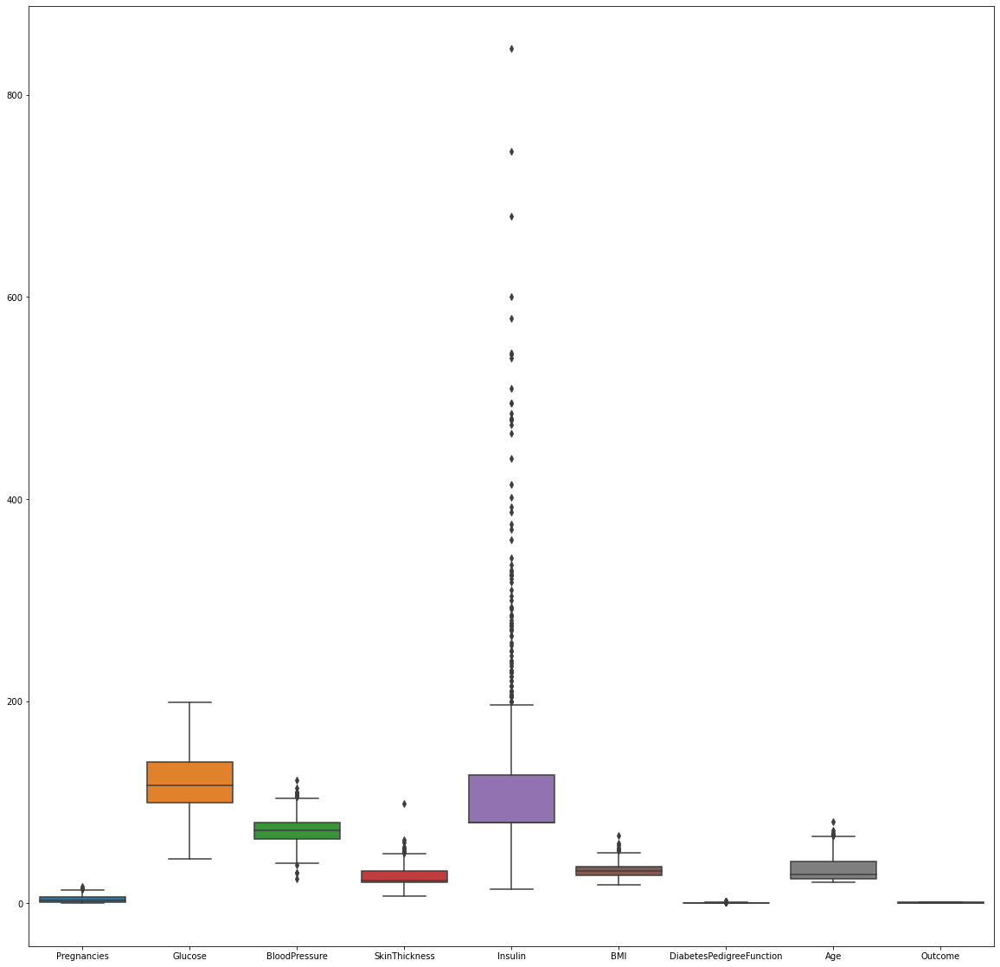

In [13]:
fig, ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df, ax = ax)

### Treatment
The below mentioned lines cleans the outliers by removing the rows in the dataset which in turn affects the outliers. 

q = df['Pregnancies'].quantile(.98)
df_new = df[df['Pregnancies'] < q]

The first line tells to store the values ofabove 98% of the quantile range. 
The next line tells the kernel to make a dataset and store the values of all the pregnencies that falls below the 98% quantile range. thereby omitting 2% of the values from the pregnancies column. 

In [14]:
q = df['Pregnancies'].quantile(.98)
df_new = df[df['Pregnancies'] < q]

q = df_new['BMI'].quantile(.99)
df_new = df_new[df_new['BMI'] < q]

q = df_new['SkinThickness'].quantile(.99)
df_new = df_new[df_new['SkinThickness'] < q]

q = df_new['Insulin'].quantile(.95)
df_new = df_new[df_new['Insulin'] < q]

q = df_new['DiabetesPedigreeFunction'].quantile(.99)
df_new = df_new[df_new['DiabetesPedigreeFunction'] < q]

q = df_new['Age'].quantile(.99)
df_new = df_new[df_new['Age'] < q]

## Function for outlier treatment. 

def outlier_removal(self,data):
    def outlier_limits(col):
        Q3, Q1 = np.nanpercentile(col, [75,25])
        IQR = Q3-Q1
        UL = Q3+1.5*IQR
        LL = Q1-1.5*IQR
        return UL,LL
    
    for column in data.columns:
        if data[column].dtype !='int64':
            UL,LL=outlier_limits(data[column])
            data[column] = np.where((data[column] > UL) | (data[column] < LL), np.nan,(data[column])
                                    
    return data
                                    
                                    

In [15]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

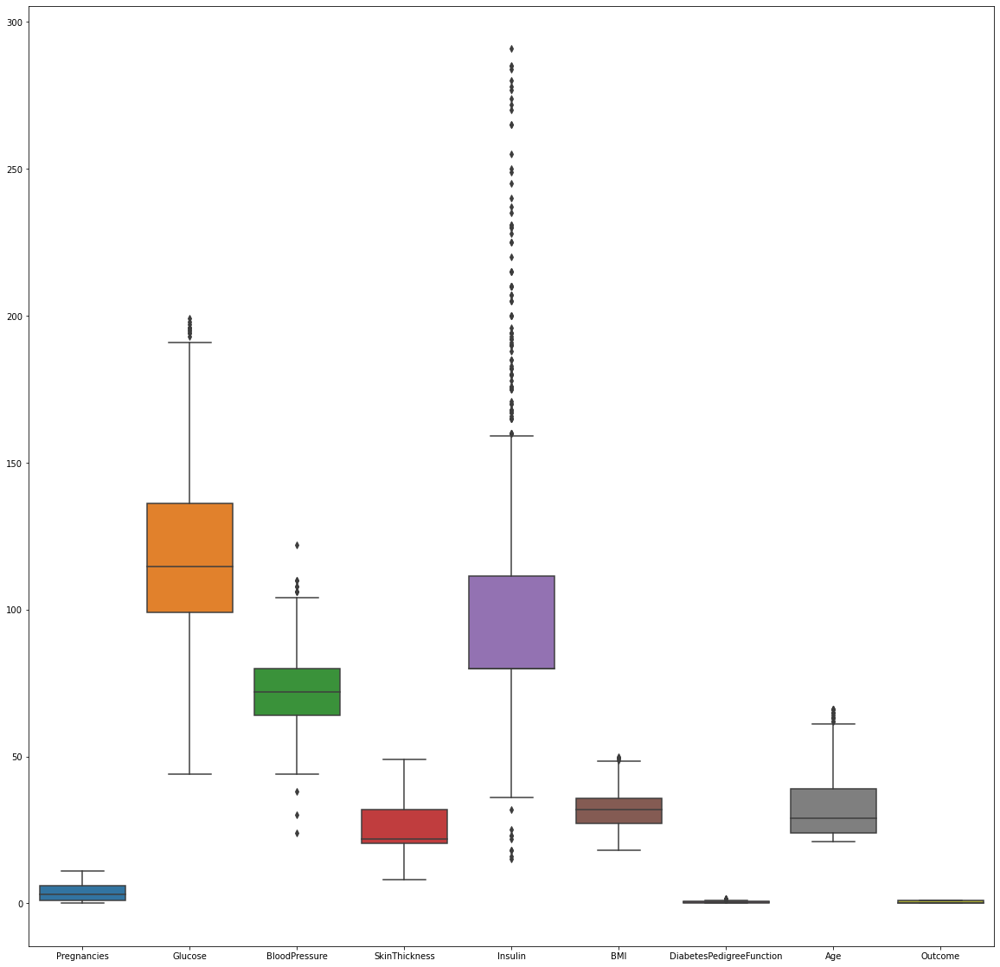

In [59]:
fig, ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new, ax = ax)

### Previously when there were outliers the histograms of each of those untreated columns were skewed. But right now they are not skewed anymore. There might be one or two outliers showing a bit unusual data but it is digestable. Some columns such as "AGE" is still skewed so other methods should be applied. 

In [17]:
ProfileReport(df_new)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [60]:
df_new.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [19]:
y = df_new['Outcome']

In [20]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [21]:
x = df_new.drop(columns = ['Outcome'])

In [22]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


## Using Standard Scalar to fir & transform the data to get the data to a standardized form. i.e. standard scaling = (xi - mean) / Standard Deviation

In [23]:
Scalar = StandardScaler()
ProfileReport(pd.DataFrame(Scalar.fit_transform(x))) 
X_scaled = Scalar.fit_transform(x)

<AxesSubplot:>

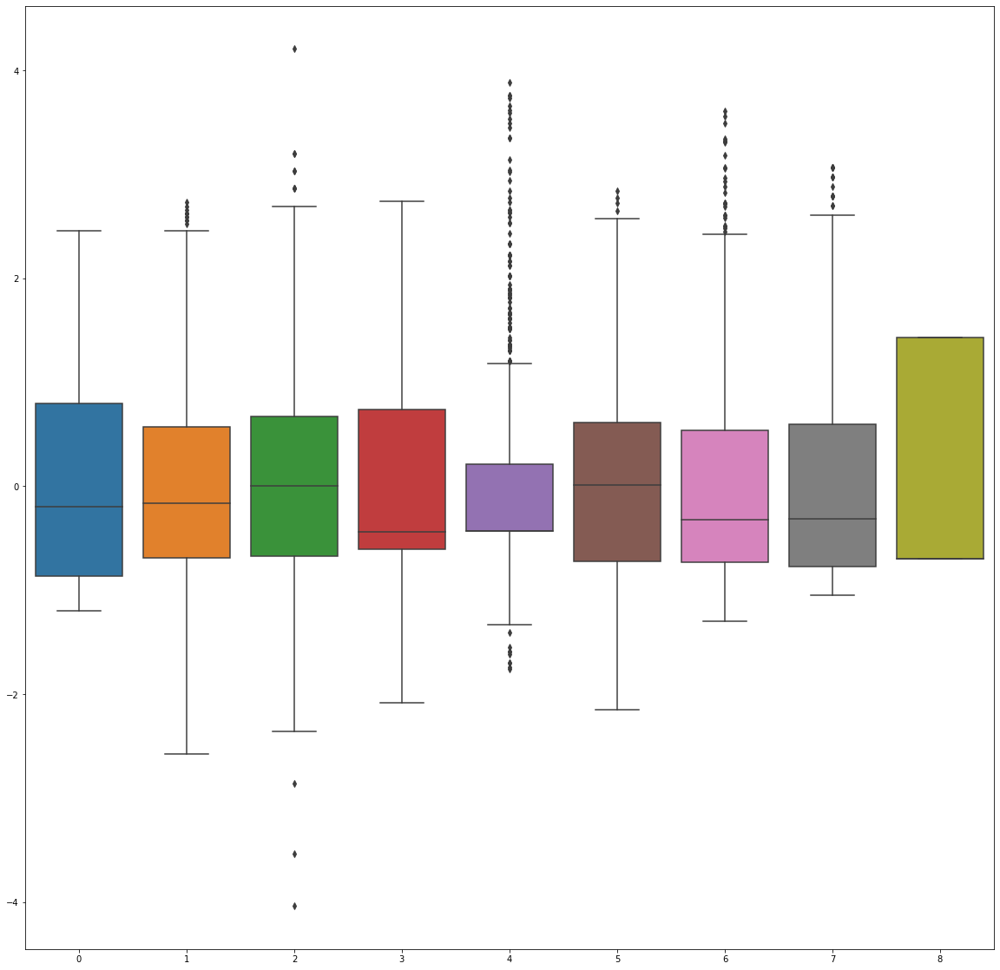

In [24]:
df_new_scalar = pd.DataFrame(Scalar.fit_transform(df_new))
fig, ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new_scalar, ax = ax)

In [25]:
X_scaled

array([[ 7.96753910e-01,  9.83984062e-01,  4.52611463e-04, ...,
         2.65819648e-01,  6.30484542e-01,  1.60141519e+00],
       [-8.64793539e-01, -1.16977621e+00, -5.04474494e-01, ...,
        -8.31445036e-01, -3.38078670e-01, -1.32706484e-01],
       [ 1.46137289e+00,  2.18051755e+00, -6.72783529e-01, ...,
        -1.34872696e+00,  7.88402456e-01, -4.14369227e-02],
       ...,
       [ 4.64444420e-01,  6.09439465e-02,  4.52611463e-04, ...,
        -8.94145875e-01, -7.10063091e-01, -2.23976046e-01],
       [-8.64793539e-01,  2.31877301e-01, -1.00940160e+00, ...,
        -2.82812694e-01, -3.45097244e-01,  1.32760650e+00],
       [-8.64793539e-01, -8.96282840e-01, -1.67856424e-01, ...,
        -2.35787064e-01, -4.64413001e-01, -8.62862978e-01]])

In [26]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [27]:
def vif_score(x):
    scaler = StandardScaler()
    arr= scaler.fit_transform(x)
    return pd.DataFrame([[x.columns[i],variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns = ["Feature", "VIF_SCORE"])



In [28]:
vif_score(x)

,Feature,VIF_SCORE
0,Pregnancies,1.449056
1,Glucose,1.304263
2,BloodPressure,1.262686
3,SkinThickness,1.470049
4,Insulin,1.271017
5,BMI,1.513160
6,DiabetesPedigreeFunction,1.042300
7,Age,1.662728


### VIF score should be greater than 10 in order for us to determine that milticolinearity exists and we should remove a column.
#### The formula for VIF score is: 
1/(1-r^2)

In [29]:
x_train, x_test, y_train, y_test= train_test_split(X_scaled , y , test_size = .20 , random_state = 144)

In [30]:
x_train

array([[-0.86479354,  0.19769063, -1.85094678, ...,  0.21879402,
         1.80609569, -0.40651517],
       [ 2.45830136,  1.22329076,  0.33707068, ...,  0.21879402,
         3.1782269 ,  1.69268475],
       [ 0.13213493,  0.91561072,  1.09446134, ..., -0.47091521,
        -0.90658316, -0.49778473],
       ...,
       [-0.86479354, -0.28092276,  1.17861586, ..., -0.28281269,
        -1.06801036, -0.86286298],
       [ 1.46137289,  0.02675728,  0.50537972, ..., -1.08224839,
        -0.13454002,  2.87918905],
       [-0.86479354, -0.75953616, -0.33616546, ..., -0.73739378,
         2.27283086, -0.95413254]])

In [31]:
x_test

array([[ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, ...,
        -4.70915211e-01, -2.50346495e-01,  1.23633694e+00],
       [-1.19710303e+00,  6.76304024e-01, -8.41092564e-01, ...,
        -1.53682948e+00, -8.43415997e-01, -1.04540210e+00],
       [ 2.45830136e+00,  8.13050708e-01,  1.85185200e+00, ...,
         7.36075942e-01, -6.78479508e-01,  1.69268475e+00],
       ...,
       [ 7.96753910e-01, -5.54416131e-01, -5.04474494e-01, ...,
        -1.19197486e+00, -6.96025943e-01, -3.15245608e-01],
       [-5.32484049e-01, -1.20396288e+00, -2.43135269e-01, ...,
         1.38528976e-02, -5.03015158e-01, -1.04540210e+00],
       [-8.64793539e-01, -1.64838960e+00, -2.01925581e+00, ...,
        -1.80330804e+00, -4.36338705e-01, -9.54132539e-01]])

In [32]:
y_train

356    1
259    1
69     0
407    0
657    0
      ..
734    0
485    1
249    0
509    0
416    0
Name: Outcome, Length: 539, dtype: int64

In [33]:
y_test

406    1
511    0
24     1
751    0
689    1
      ..
3      0
469    0
587    0
60     0
97     0
Name: Outcome, Length: 135, dtype: int64

## Playing with the outcomes. 

We are using the first row in the x_test dataset to predict whether the person is diabetic or not

In [34]:
x_test[0]

array([ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, -6.09921498e-01,
       -4.34192020e-01, -4.70915211e-01, -2.50346495e-01,  1.23633694e+00])

In [35]:
logr = LogisticRegression(verbose = 1 ) # Verbose 1 displays the log

In [36]:
logr.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s finished


LogisticRegression(verbose=1)

### Here we are predicting the value. 0 or 1. 
#### The first one says that there is an 83 percent of chance of the row to be a non diabetic and 16 percent of chance to be a diabetic.
#### The second one displays the loggit function which tells us the side of the line the points are in. 
#### the third one predicts the output directly, 0 or 1

In [37]:
logr.predict_proba([x_test[0]])

array([[0.83549024, 0.16450976]])

In [38]:
logr.predict_log_proba([x_test[0]])

array([[-0.17973662, -1.80478536]])

In [39]:
logr.predict([x_test[0]])

array([0])

In [40]:
y_test.iloc[0]

1

In [41]:
logr.predict_proba([x_test[1]])

array([[0.91629065, 0.08370935]])

In [42]:
logr.predict_log_proba([x_test[1]])

array([[-0.08742167, -2.48040456]])

In [43]:
logr.predict([x_test[1]])

array([0])

In [44]:
y_test.iloc[1]

0

# Changing the solver to Liblinear.

In [45]:
logr_liblinear = LogisticRegression(verbose = 1,solver='liblinear') # changing the solver

In [46]:
logr_deafult = LogisticRegression(verbose = 1 ) # Verbose 1 displays the log

In [47]:
logr_liblinear.fit(x_train,y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [48]:
logr_deafult.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


LogisticRegression(verbose=1)

In [49]:
y_pred_liblinear = logr_liblinear.predict(x_test)
y_pred_liblinear

array([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0])

In [50]:
y_pred_default = logr_deafult.predict(x_test)
y_pred_default

array([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0])

In [51]:
confusion_matrix(y_test,y_pred_liblinear)

array([[77, 10],
       [24, 24]])

In [52]:
confusion_matrix(y_test,y_pred_default)

array([[77, 10],
       [24, 24]])

In [53]:
def model_eval(y_true,y_pred):
    tn, fp, fn, tp = confusion_matrix(y_test,y_pred).ravel()
    accuracy = (tp+tn)/(tp+tn+fp+fn)
    precision = tp/(tp+fp)
    recall = tp/(tp+fn)
    specificity = tn/(fp+tn)
    F1_score = 2 * (recall * precision)/(recall + precision)
    result ={"Accuracy":accuracy,"Precision":precision,"Recall":recall,"Specificity":specificity,"F1_score":F1_score}
    return result
model_eval(y_test,y_pred_liblinear)

{'Accuracy': 0.7481481481481481,
 'Precision': 0.7058823529411765,
 'Recall': 0.5,
 'Specificity': 0.8850574712643678,
 'F1_score': 0.5853658536585366}

In [54]:
model_eval(y_test,y_pred_default)

{'Accuracy': 0.7481481481481481,
 'Precision': 0.7058823529411765,
 'Recall': 0.5,
 'Specificity': 0.8850574712643678,
 'F1_score': 0.5853658536585366}

In [55]:
auc = roc_auc_score(y_test,y_pred_liblinear)

In [56]:
roc_auc_score(y_test,y_pred_default)

0.692528735632184

In [57]:
fpr, tpr, thresholds = roc_curve(y_test,y_pred_liblinear) # 3 outputs are FPR, TPR, Threshold

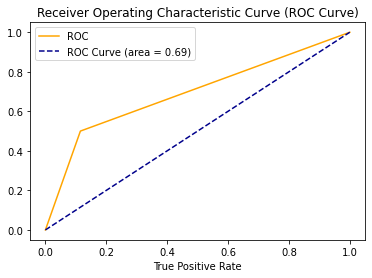

In [58]:
plt.plot(fpr, tpr, color ='orange', label='ROC')
plt.plot([0,1], [0,1], color ='darkblue', linestyle='--', label = 'ROC Curve (area = %0.2f)' %auc)
plt.xlabel('False Positive Rate')
plt.xlabel('True Positive Rate')
plt.title('Receiver Operating Characteristic Curve (ROC Curve)')
plt.legend()
plt.show()